## SI 699 Project

Sections:

- Extracting Frames
- Running API from Roboflow to get coordinates of objects in frames
    - https://universe.roboflow.com/capstone-ejkpk/basketbrain
    - Several options in the document, depending on what it is being used for
- Using pytesseract to only save frames with shot times (using data from ESPN Webscraper)
- Attempting to assign colors per team -> work in progress
- Performing homography on the image

Loading in required libraries

In [ ]:
import cv2
import os
import glob
import pandas as pd
import numpy as np
import re
import subprocess
from inference_sdk import InferenceHTTPClient
import json
import random
import shutil
import csv
from collections import Counter
from PIL import Image, ImageOps, ImageEnhance, ImageDraw
import pytesseract
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle, Arc, Circle

# Extracting Frames

Fastest Method:

In [ ]:
# Extracting frames from folder of downloaded youtube videos

video_folder = "yt-dlp"
output_folder = "extracted_frames_fast"
os.makedirs(output_folder, exist_ok=True)

# Needed to use regex to process the video titles
def parse_video_info(title):
    title = title.replace('：', ':').replace('｜', '|').replace('–', '-').replace('—', '-')

    match = re.match(r"(.*?) vs\. (.*?)[:\-] (.*?)(?: \|| \[| FULL|$)", title)
    if match:
        team1 = match.group(1).strip()
        team2 = match.group(2).strip()
        round_info = match.group(3).strip()
    else:
        # Some titles had different format, used original youtube video ID for those
        video_id_match = re.search(r"\[([a-zA-Z0-9_-]{6,})\]", title)
        suffix = video_id_match.group(1) if video_id_match else title[-6:]
        team1, team2, round_info = "Team1", "Team2", f"Round_{suffix}"

    return team1, team2, round_info

# Use cleaned names for new folders where images will appear
def sanitize(text):
    return re.sub(r'[<>:"/\\|?*–—“”‘’]', '_', text)

# Using FFmeg to extracvt images
def extract_with_ffmpeg(video_path, output_folder):
    os.makedirs(output_folder, exist_ok=True)
    base_name = os.path.basename(output_folder)
    output_pattern = os.path.join(output_folder, f"{base_name}_frame_%04d.jpg")
    command = [
        "ffmpeg",
        "-i", video_path,
        "-vf", "fps=1,scale=960:-1",  # 1 frame per second
        "-qscale:v", "4", # quality setting, should be between 2-5, anything above 5 will make it slower
        output_pattern
    ]
    subprocess.run(command, stdout=subprocess.DEVNULL, stderr=subprocess.STDOUT)

# Process all videos
video_files = glob.glob(os.path.join(video_folder, "*.mp4"))

for video_path in video_files:
    video_name_raw = os.path.splitext(os.path.basename(video_path))[0]
    team1, team2, round_info = parse_video_info(video_name_raw)
    team1_clean = sanitize(team1)
    team2_clean = sanitize(team2)
    round_clean = sanitize(round_info)

    folder_name = f"{team1_clean}_vs_{team2_clean}_{round_clean}"
    video_output_folder = os.path.join(output_folder, folder_name)

    if os.path.exists(video_output_folder):
        print(f"Skipping {folder_name} (already processed)")
        continue

    print(f"Processing {folder_name}...")
    extract_with_ffmpeg(video_path, video_output_folder)
    print(f"Finished processing {folder_name}")

print("All videos processed!")


Skipping Alabama_vs_Florida State_2024 NCAA women's first round (already processed)
Skipping Baylor_vs_Vanderbilt_2024 NCAA women_s first round (already processed)
Skipping Baylor_vs_Virginia Tech_2024 NCAA women_s second round (already processed)
Skipping Colorado_vs_Drake_2024 NCAA women_s first round (already processed)
Skipping Colorado_vs_Kansas State_2024 NCAA women_s second round (already processed)
Skipping Creighton_vs_UNLV_2024 NCAA women_s first round (already processed)
Skipping Duke_vs_Ohio State_2024 NCAA women's second round (already processed)
Skipping Duke_vs_Richmond_2024 NCAA women_s first round (already processed)
Skipping Gonzaga_vs_UC Irvine_2024 NCAA women_s first round (already processed)
Processing Gonzaga_vs_Utah_2024 NCAA women's second round at 1 FPS using FFmpeg...
Finished processing Gonzaga_vs_Utah_2024 NCAA women's second round
Skipping Indiana_vs_Fairfield_2024 NCAA women_s first round (already processed)
Skipping Indiana_vs_Oklahoma_2024 NCAA women_s s

# Running Already Trained Model on Data

With no restrictions and using API connected to roboflow website, and annotated images:

In [ ]:
# # Initialize Roboflow client
# CLIENT = InferenceHTTPClient(
#     api_url="https://detect.roboflow.com",
#     api_key="KEY"
# )

# # Folder containing frames
# frame_folder = "extracted_frames_fast"

# # Output folder for annotated images
# output_folder = "annotated_frames2_nocolor"
# os.makedirs(output_folder, exist_ok=True)

# # Loop through all images in the folder
# for image_file in os.listdir(frame_folder):
#     if image_file.endswith(".jpg") or image_file.endswith(".png"):
#         image_path = os.path.join(frame_folder, image_file)

#         result = CLIENT.infer(image_path, model_id="basketbrain/1")

#         # Print result for debugging
#         print(json.dumps(result, indent=4))

#         image = cv2.imread(image_path)

#         # Draw bounding boxes
#         for prediction in result['predictions']:
#             x, y, w, h = int(prediction["x"]), int(prediction["y"]), int(prediction["width"]), int(prediction["height"])
#             confidence = prediction["confidence"]

#             # Draw the bounding box
#             cv2.rectangle(image, (x - w // 2, y - h // 2), (x + w // 2, y + h // 2), (0, 255, 0), 2)
#             cv2.putText(image, f"{confidence:.2f}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

#         # Save the annotated image
#         output_path = os.path.join(output_folder, image_file)
#         cv2.imwrite(output_path, image)

# print("Finished processing all frames!")

One annotated image - for poster

In [ ]:
# One annotated image

CLIENT = InferenceHTTPClient(
    api_url="https://detect.roboflow.com",
    api_key="KEY"
)


image_path = "extracted_frames_fast/Alabama_vs_Florida State_2024 NCAA women_s first round/frame_4089.jpg"
output_path = "check_image.jpg"
result = CLIENT.infer(image_path, model_id="basketbrain/1")

# Print result for debugging
print(json.dumps(result, indent=4))

image = cv2.imread(image_path)

# Colors for cetain classes, to make image better for poster
PREDEFINED_COLORS = {
    "Player": (0, 255, 255),   # Yellow
    "Ref": (255, 0, 0),        # Blue
    "Ball": (0, 140, 255),     # Orange
}

# Assigning random color for other classes, don't care about specific colors
class_colors = {}
def get_class_color(class_name):
    if class_name in PREDEFINED_COLORS:
        return PREDEFINED_COLORS[class_name]
    if class_name not in class_colors:
        class_colors[class_name] = (
            random.randint(0, 255),
            random.randint(0, 255),
            random.randint(0, 255)
        )
    return class_colors[class_name]

# Draw bounding boxes
for prediction in result['predictions']:
    x, y = int(prediction["x"]), int(prediction["y"])
    w, h = int(prediction["width"]), int(prediction["height"])
    confidence = prediction["confidence"]
    class_name = prediction["class"]

    color = get_class_color(class_name)

    # Draw bounding box and label
    cv2.rectangle(image, (x - w // 2, y - h // 2), (x + w // 2, y + h // 2), color, 2)
    cv2.putText(image, f"{class_name} {confidence:.2f}", (x - w // 2, y - h // 2 - 10),
                cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

# Save the annotated image
cv2.imwrite(output_path, image)
print(f"Annotated image saved to {output_path}")


{
    "inference_id": "5b27c8e8-f1f9-4785-83f7-d40542ac9869",
    "time": 0.044874965999042615,
    "image": {
        "width": 1280,
        "height": 720
    },
    "predictions": [
        {
            "x": 563.0,
            "y": 621.0,
            "width": 48.0,
            "height": 42.0,
            "confidence": 0.9044544100761414,
            "class": "Team Points",
            "class_id": 9,
            "detection_id": "de0e3048-6da5-4b58-b2af-6c32cb633905"
        },
        {
            "x": 356.0,
            "y": 178.5,
            "width": 42.0,
            "height": 41.0,
            "confidence": 0.9028353691101074,
            "class": "Hoop",
            "class_id": 2,
            "detection_id": "491f999b-f981-4c2e-b6ed-2a4420e4e765"
        },
        {
            "x": 308.0,
            "y": 437.5,
            "width": 56.0,
            "height": 147.0,
            "confidence": 0.9018625020980835,
            "class": "Player",
            "class_id": 5,
     

### With only hoop - using API - slow

In [ ]:
# Hoop using call to API

CLIENT = InferenceHTTPClient(
    api_url="https://detect.roboflow.com",
    api_key="KEY"
)

# Input and output folders
frame_folder = "baylor_test_folder"
output_folder = "frames_with_hoop"
os.makedirs(output_folder, exist_ok=True)

# CSV file for bounding box summary
csv_path = os.path.join(output_folder, "player_coordinates_summary.csv")
csv_fields = ["image_name", "player_id", "x", "y", "width", "height", "confidence"]

saved_count = 0
skipped_count = 0

with open(csv_path, mode="w", newline="") as csv_file:
    writer = csv.DictWriter(csv_file, fieldnames=csv_fields)
    writer.writeheader()

    for image_file in os.listdir(frame_folder):
        if image_file.endswith(".jpg") or image_file.endswith(".png"):
            image_path = os.path.join(frame_folder, image_file)

            result = CLIENT.infer(image_path, model_id="basketbrain/1")

            json_filename = image_file.rsplit(".", 1)[0] + ".json"
            json_output_path = os.path.join(output_folder, json_filename)
            with open(json_output_path, "w") as json_file:
                json.dump(result, json_file, indent=4)

            # Check if a Hoop is present in predictions
            hoop_present = any(p["class"] == "Hoop" for p in result["predictions"])

            if hoop_present:
                saved_count += 1

                # annotate image
                image = cv2.imread(image_path)
                for idx, prediction in enumerate(result["predictions"]):
                    x, y = int(prediction["x"]), int(prediction["y"])
                    w, h = int(prediction["width"]), int(prediction["height"])
                    confidence = prediction["confidence"]

                    # Draw bounding box and confidence
                    cv2.rectangle(image, (x - w // 2, y - h // 2), (x + w // 2, y + h // 2), (0, 255, 0), 2)
                    cv2.putText(image, f"{confidence:.2f}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

                    # Writing to CSV only for "Player" class
                    if prediction["class"] == "Player":
                        writer.writerow({
                            "image_name": image_file,
                            "player_id": idx,
                            "x": x,
                            "y": y,
                            "width": w,
                            "height": h,
                            "confidence": confidence
                        })

                output_image_path = os.path.join(output_folder, image_file)
                cv2.imwrite(output_image_path, image)
            else:
                skipped_count += 1

print("Finished processing all frames!")
print(f"Frames saved (with hoop): {saved_count}")
print(f"Frames skipped (no hoop): {skipped_count}")

Finished processing all frames!
Frames saved (with hoop): 1239
Frames skipped (no hoop): 2201


### Unannotated - using API - slow

In [ ]:
# Same as above, just unannotated

CLIENT = InferenceHTTPClient(
    api_url="https://detect.roboflow.com",
    api_key="KEY"
)

frame_folder = "alabama_floridast_frames"
output_folder = "alabama_frames_with_hoop_unannotated"
os.makedirs(output_folder, exist_ok=True)

saved_count = 0
skipped_count = 0

for image_file in os.listdir(frame_folder):
    if image_file.endswith(".jpg") or image_file.endswith(".png"):
        image_path = os.path.join(frame_folder, image_file)

        result = CLIENT.infer(image_path, model_id="basketbrain/1")

        # Save JSON output to the output folder
        json_filename = image_file.rsplit(".", 1)[0] + ".json"
        json_output_path = os.path.join(output_folder, json_filename)
        with open(json_output_path, "w") as json_file:
            json.dump(result, json_file, indent=4)

        # Checking if a Hoop is present in predictions
        hoop_present = any(p["class"] == "Hoop" for p in result["predictions"])

        if hoop_present:
            saved_count += 1
            output_image_path = os.path.join(output_folder, image_file)
            shutil.copy(image_path, output_image_path)
        else:
            skipped_count += 1

print("Finished processing all frames!")
print(f"Frames saved (with hoop): {saved_count}")
print(f"Frames skipped (no hoop): {skipped_count}")


Finished processing all frames!
Frames saved (with hoop): 1911
Frames skipped (no hoop): 1700


### With hoop only - using locally hosted method - FASTEST and Method Used for our purposes

Need to start docker using terminal.

>cd "C:\Users\sfisch\Desktop\SI 699 Project"

>rf-env\Scripts\activate.bat

>docker pull roboflow/roboflow-inference-server-cpu:latest

>inference server start

In [ ]:
# This was after running Docker using the above specifications in the terminal
# Once Docker Desktop is running, then below code is run


CLIENT = InferenceHTTPClient(
    api_url="http://localhost:9001",
    api_key="KEY"
)

input_root = "extracted_frames_fast"
output_root = "frames_with_hoop_unannotated5"
os.makedirs(output_root, exist_ok=True)

# regex to clean up folder names
def sanitize(text):
    return re.sub(r'[<>:"/\\|?*–—“”‘’]', "_", text)

total_saved = 0
total_skipped = 0
games_processed = 0

# Loop over each game folder
for game_folder in os.listdir(input_root):
    input_game_path = os.path.join(input_root, game_folder)
    if not os.path.isdir(input_game_path):
        continue

    game_name = sanitize(game_folder)
    output_game_path = os.path.join(output_root, game_name)

    if os.path.exists(output_game_path):
        print(f"Skipping {game_folder} (already processed)")
        continue

    os.makedirs(output_game_path, exist_ok=True)

    saved_count = 0
    skipped_count = 0
    print(f"Processing {game_folder}...")

    for image_file in os.listdir(input_game_path):
        if not image_file.lower().endswith((".jpg", ".jpeg", ".png")):
            continue

        image_path = os.path.join(input_game_path, image_file)
        base_name, _ = os.path.splitext(image_file)

        try:
            result = CLIENT.infer(image_path, model_id="basketbrain/1")
        except Exception as e:
            print(f"Error processing {image_file}: {e}")
            skipped_count += 1
            continue

        # Save image & json only if hoop is detected
        if any(pred["class"] == "Hoop" for pred in result["predictions"]):
            # Copy the image under its original name
            shutil.copy(image_path, os.path.join(output_game_path, image_file))

            json_output_path = os.path.join(output_game_path, f"{base_name}.json")
            with open(json_output_path, "w") as f:
                json.dump(result, f, indent=2)

            saved_count += 1
        else:
            skipped_count += 1

    print(f"{game_folder} Saved: {saved_count}, Skipped: {skipped_count}")
    total_saved += saved_count
    total_skipped += skipped_count
    games_processed += 1

print("\nAll games processed!")
print(f"Games processed: {games_processed}")
print(f"Total frames saved (with hoop): {total_saved}")
print(f"Total frames skipped (no hoop): {total_skipped}")

⏭Skipping Alabama_vs_Florida State_2024 NCAA women_s first round (already processed)
⏭Skipping Baylor_vs_Vanderbilt_2024 NCAA women_s first round (already processed)
⏭Skipping Baylor_vs_Virginia Tech_2024 NCAA women_s second round (already processed)
⏭Skipping Colorado_vs_Drake_2024 NCAA women_s first round (already processed)
⏭Skipping Colorado_vs_Kansas State_2024 NCAA women_s second round (already processed)
⏭Skipping Creighton_vs_UNLV_2024 NCAA women_s first round (already processed)
⏭Skipping Duke_vs_Ohio State_2024 NCAA women's second round (already processed)
⏭Skipping Duke_vs_Richmond_2024 NCAA women_s first round (already processed)
⏭Skipping Gonzaga_vs_UC Irvine_2024 NCAA women_s first round (already processed)
⏭Skipping Gonzaga_vs_Utah_2024 NCAA women's second round (already processed)
⏭Skipping Indiana_vs_Fairfield_2024 NCAA women_s first round (already processed)
⏭Skipping Indiana_vs_Oklahoma_2024 NCAA women_s second round (already processed)
⏭Skipping Iowa State_vs_Maryla

# Attempt to sort teams with color - Not Working

ideas to try:
- create a list of five most prominent colors of boudning box
- for only the player class, "class": "Player"

- approximate for one half of a game by hand

Using baylor vs vanderbilt as test:

In [ ]:
# Color attempt to sort teams

CLIENT = InferenceHTTPClient(
    api_url="https://detect.roboflow.com",
    api_key="KEY"
)

frame_folder = "baylor_test_folder"
output_folder = "annotated_frames2"
os.makedirs(output_folder, exist_ok=True)

# Function to calculate perceived brightness
def calculate_brightness(color):
    r, g, b = color
    return 0.299 * r + 0.587 * g + 0.114 * b

# Function to determine if a player is wearing a light or dark jersey
def is_light_color(color_list):
    brightness_values = [calculate_brightness(color) for color in color_list]
    avg_brightness = np.mean(brightness_values)
    return avg_brightness > 127  # Threshold for light or dark

# Function to extract top 5 colors from a player's bounding box
def get_top_colors(image, bbox, num_colors=5):
    x, y, w, h = bbox

    # Crop the player's bounding box to avoid unncessary extra colors
    cropped_player = image[max(0, y - h // 2): min(image.shape[0], y + h // 2),
                           max(0, x - w // 2): min(image.shape[1], x + w // 2)]

    if cropped_player.size == 0:
        return []

    cropped_player = cv2.resize(cropped_player, (50, 100))
    cropped_rgb = cv2.cvtColor(cropped_player, cv2.COLOR_BGR2RGB)
    pixels = cropped_rgb.reshape(-1, 3)

    # Count of each color
    pixel_counts = Counter(map(tuple, pixels))
    top_colors = [color for color, _ in pixel_counts.most_common(num_colors)]

    return top_colors

# Store player color data
player_colors = {}
baylor_count = 0  # Light jerseys = Baylor
vanderbilt_count = 0  # Dark jerseys = Vanderbilt

# Loop through all images in the folder
for image_file in os.listdir(frame_folder):
    if image_file.endswith(".jpg") or image_file.endswith(".png"):
        image_path = os.path.join(frame_folder, image_file)

        result = CLIENT.infer(image_path, model_id="basketbrain/1")
        print(json.dumps(result, indent=4))

        image = cv2.imread(image_path)

        if image is None:
            print(f"Error: Could not read {image_path}")
            continue

        # Process each detected player
        for i, prediction in enumerate(result['predictions']):
            if prediction["class"] != "Player":
                continue

            x, y, w, h = int(prediction["x"]), int(prediction["y"]), int(prediction["width"]), int(prediction["height"])
            confidence = prediction["confidence"]

            top_colors = get_top_colors(image, (x, y, w, h))

            if is_light_color(top_colors):
                baylor_count += 1
                team = "Baylor"
                box_color = (0, 255, 0)  # Green for Baylor
            else:
                vanderbilt_count += 1
                team = "Vanderbilt"
                box_color = (255, 0, 0)  # Red for Vanderbilt

            player_colors[f"{image_file}_player_{i}"] = {"colors": top_colors, "team": team}

            # Draw bounding box with team color
            cv2.rectangle(image, (x - w // 2, y - h // 2), (x + w // 2, y + h // 2), box_color, 2)
            cv2.putText(image, f"{team}", (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, box_color, 2)

        output_path = os.path.join(output_folder, image_file)
        cv2.imwrite(output_path, image)

# Save player color data to json
with open("player_colors.json", "w") as f:
    json.dump(player_colors, f, indent=4)

print(f"Baylor players (light jerseys): {baylor_count}, Vanderbilt players (dark jerseys): {vanderbilt_count}")

print("Finished processing all frames! Player colors and teams saved.")


{
    "inference_id": "88ce5a41-982e-48fc-8162-73631e59d67a",
    "time": 0.032451272000344034,
    "image": {
        "width": 1280,
        "height": 720
    },
    "predictions": [
        {
            "x": 714.0,
            "y": 619.5,
            "width": 54.0,
            "height": 37.0,
            "confidence": 0.919407308101654,
            "class": "Team Points",
            "class_id": 9,
            "detection_id": "45b91e9f-7e90-49f3-ae5a-a32c722b5697"
        },
        {
            "x": 323.5,
            "y": 192.0,
            "width": 45.0,
            "height": 50.0,
            "confidence": 0.9140536189079285,
            "class": "Hoop",
            "class_id": 2,
            "detection_id": "3a5db09b-cc6b-417d-a9b6-fd02be040899"
        },
        {
            "x": 560.0,
            "y": 620.0,
            "width": 52.0,
            "height": 34.0,
            "confidence": 0.9052746295928955,
            "class": "Team Points",
            "class_id": 9,
  

TypeError: Object of type uint8 is not JSON serializable

# Cleaning CSV Files to get ready for time of game detection

In [ ]:
# Cleaning csv files

input_folder = "game_data"
output_folder = "game_data2"
os.makedirs(output_folder, exist_ok=True)

for filename in os.listdir(input_folder):
    if filename.endswith(".csv"):
        input_path = os.path.join(input_folder, filename)
        output_path = os.path.join(output_folder, filename)

        df = pd.read_csv(input_path)

        # Filter rows where shooting_play is True
        df_filtered = df[df['shooting_play'] == True].copy()

        df_filtered.to_csv(output_path, index=False)
        print(f"Saved cleaned file: {output_path}")

print("\nAll files processed and saved to 'game_data2'.")


Saved cleaned file: game_data2\Alabama_vs_Florida State_2024 NCAA women_s first round.csv
Saved cleaned file: game_data2\Baylor_vs_Vanderbilt_2024 NCAA women_s first round.csv
Saved cleaned file: game_data2\Baylor_vs_Virginia Tech_2024 NCAA women_s second round.csv
Saved cleaned file: game_data2\Colorado_vs_Drake_2024 NCAA women_s first round.csv
Saved cleaned file: game_data2\Colorado_vs_Kansas State_2024 NCAA women_s second round.csv
Saved cleaned file: game_data2\Creighton_vs_UNLV_2024 NCAA women_s first round.csv
Saved cleaned file: game_data2\Duke_vs_Ohio State_2024 NCAA women's second round.csv
Saved cleaned file: game_data2\Duke_vs_Richmond_2024 NCAA women_s first round.csv
Saved cleaned file: game_data2\Gonzaga_vs_UC Irvine_2024 NCAA women_s first round.csv
Saved cleaned file: game_data2\Gonzaga_vs_Utah_2024 NCAA women's second round.csv
Saved cleaned file: game_data2\Indiana_vs_Fairfield_2024 NCAA women_s first round.csv
Saved cleaned file: game_data2\Indiana_vs_Oklahoma_2024 

## FILTERING FOR IMAGES THAT CORRESPOND TO SHOT TIME

With new csv files in folder

In [ ]:
# Filtering for time in game, and quarter

FRAMES_ROOT       = "frames_with_hoop_unannotated5"
CSV_ROOT          = "game_data2"
OUTPUT_ROOT       = "game_shots"
DEBUG             = False # change to True to see each image pop up
TIME_MARGIN       = 4.5
PERIOD_MARGIN     = 2.0
FUZZY_MARGIN_SEC  = 1 # + or - 1 second tolerance

# where pytesseract is saved
pytesseract.pytesseract.tesseract_cmd = (
    r"C:\Program Files\Tesseract-OCR\tesseract.exe"
)

def time_str_to_seconds(t: str) -> int | None:
    try:
        m, s = map(int, t.split(":"))
        return m*60 + s
    except:
        return None

os.makedirs(OUTPUT_ROOT, exist_ok=True)

# Looping through games
for game in os.listdir(FRAMES_ROOT):
    game_folder = os.path.join(FRAMES_ROOT, game)
    if not os.path.isdir(game_folder):
        continue

    csv_path = os.path.join(CSV_ROOT, f"{game}.csv")
    if not os.path.isfile(csv_path):
        print(f"Missing CSV for '{game}' → {csv_path}")
        continue

    df = pd.read_csv(csv_path)
    if "secs_left_qt" not in df.columns or "quarter" not in df.columns:
        print(f"'{game}.csv' needs 'secs_left_qt' & 'quarter' columns")
        continue

    shot_by_quarter = {
        int(q): set(group["secs_left_qt"].dropna().astype(int))
        for q, group in df.groupby("quarter")
    }
    print(f"[{game}] quarters in CSV: {list(shot_by_quarter.keys())}")

    out_dir = os.path.join(OUTPUT_ROOT, game)
    os.makedirs(out_dir, exist_ok=True)

    # process each JSON+JPG
    for fn in os.listdir(game_folder):
        if not fn.lower().endswith(".json"):
            continue

        base     = fn[:-5]
        json_pth = os.path.join(game_folder, fn)
        img_pth  = os.path.join(game_folder, base + ".jpg")
        if not os.path.isfile(img_pth):
            continue

        preds = json.load(open(json_pth)).get("predictions", [])
        img   = Image.open(img_pth)

        # OCR Time Remaining
        tbox = next((p for p in preds if p.get("class")=="Time Remaining"), None)
        if not tbox:
            continue
        tx, ty = int(tbox["x"]), int(tbox["y"])
        tw, th = int(tbox["width"]), int(tbox["height"])
        tcrop = img.crop((
            tx - tw//2 - TIME_MARGIN,
            ty - th//2 - TIME_MARGIN,
            tx + tw//2 + TIME_MARGIN,
            ty + th//2 + TIME_MARGIN
        ))
        gray    = tcrop.convert("L")
        inv     = ImageOps.invert(gray)
        cont    = ImageEnhance.Contrast(inv).enhance(2.0)
        bw      = cont.point(lambda p:255 if p>128 else 0)
        up_t    = bw.resize((bw.width*2, bw.height*2),
                            Image.Resampling.LANCZOS)
        text    = pytesseract.image_to_string(up_t, config="--oem 3 --psm 7").strip()
        m_time  = re.search(r"\b\d{1,2}:\d{2}\b", text)
        secs    = time_str_to_seconds(m_time.group(0)) if m_time else None

        # OCR Period
        pbox = next((p for p in preds if p.get("class")=="Period"), None)
        if not pbox or secs is None:
            continue
        px, py = int(pbox["x"]), int(pbox["y"])
        pw, ph = int(pbox["width"]), int(pbox["height"])
        pcrop = img.crop((
            px - pw//2 - PERIOD_MARGIN,
            py - ph//2 - PERIOD_MARGIN,
            px + pw//2 + PERIOD_MARGIN,
            py + ph//2 + PERIOD_MARGIN
        ))
        pgray  = pcrop.convert("L")
        pinv   = ImageOps.invert(pgray)
        pcont  = ImageEnhance.Contrast(pinv).enhance(2.0)
        pbw    = pcont.point(lambda p:255 if p>128 else 0)
        up_p   = pbw.resize((pbw.width*2, pbw.height*2),
                            Image.Resampling.LANCZOS)
        ptext  = pytesseract.image_to_string(up_p, config="--oem 3 --psm 7").strip().upper()

        # extract the leading digit before “Q”
        pm = re.search(r"([1-4])\s*Q", ptext)
        if pm:
            quarter = int(pm.group(1))
        else:
            # fallback to any standalone digit 1–4
            m_digit = re.search(r"[1-4]", ptext)
            quarter = int(m_digit.group(0)) if m_digit else None

        if DEBUG:
            dbg = img.copy()
            d = ImageDraw.Draw(dbg)
            d.rectangle(tcrop.getbbox(), outline="red",   width=2)  # time box
            d.rectangle(pcrop.getbbox(), outline="blue",  width=2)  # period box
            dbg.show(title=f"{base}: Time=RED, Period=BLUE")
            up_t.show(title="Time crop for OCR")
            up_p.show(title="Period crop for OCR")
            print(f"   → OCR time: '{text}' → {secs}s;  period OCR: '{ptext}' → {quarter}")

        # same quarter & + or - 1 s
        if (quarter in shot_by_quarter and
            any(abs(secs - s) <= FUZZY_MARGIN_SEC
                for s in shot_by_quarter[quarter])
        ):
            print(f"YES: [{game}] {base} @ {m_time.group(0)} Q{quarter}")
            shutil.copy2(img_pth,  out_dir)
            shutil.copy2(json_pth, out_dir)
        else:
            print(f"NO: [{game}] {base}: time='{text}' q='{ptext}'")

🔍 [Alabama_vs_Florida State_2024 NCAA women_s first round] quarters in CSV: [1, 2, 3, 4]
❌ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0043: time='9:56' q='1Q'
❌ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0044: time='9:55' q='1Q'
❌ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0045: time='9:54' q='1Q'
❌ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0046: time='9:53' q='1Q'
❌ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0047: time='9:52' q='1Q'
❌ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0048: time='9:51' q='1Q'
✅ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0049 @ 9:50 Q1
❌ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0050: time='3:49' q='1Q'
✅ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0051 @ 9:48 Q1
❌ [Alabama_vs_Florida State_2024 NCAA women_s first round] frame_0052: time='9:47' q='1Q'
❌ [Alabama_vs_Florida State_202

KeyboardInterrupt: 

## Homography

For right pixels: Alabama vs Florida State - frames_with_hoop_unnannotated - frame_3245 was used </br>
For left pixels: Alabama vs Florida State - frames_with_hoop_unnannotated - frame_0148 was used

In [ ]:
# Homography

# image used
img = cv2.imread("frames_with_hoop_unannotated5/Alabama_vs_Florida State_2024 NCAA women_s first round/frame_3245.jpg")
orig_h, orig_w = img.shape[:2]

# maximum display dimension to view entire image, on my small windows laptop screen
MAX_DISPLAY_SIZE = 800
scale = min(MAX_DISPLAY_SIZE/orig_w, MAX_DISPLAY_SIZE/orig_h, 1.0)
disp_w, disp_h = int(orig_w * scale), int(orig_h * scale)

cv2.namedWindow("Click 4 points", cv2.WINDOW_NORMAL)
cv2.resizeWindow("Click 4 points", disp_w, disp_h)

pts = []

def on_click(event, x, y, flags, param):
    # map (x,y) in the down‑scaled image back to original coords
    if event == cv2.EVENT_LBUTTONDOWN and len(pts) < 4:
        orig_x = int(x / scale)
        orig_y = int(y / scale)
        pts.append((orig_x, orig_y))
        print(f"Point {len(pts)} (orig coords): {(orig_x, orig_y)}")

cv2.setMouseCallback("Click 4 points", on_click)

# show the resized image and collect clicks
while True:
    disp = cv2.resize(img, (disp_w, disp_h), interpolation=cv2.INTER_AREA).copy()
    for (ox, oy) in pts:
        # draw on the resized display
        cv2.circle(disp, (int(ox*scale), int(oy*scale)), 8, (0,0,255), -1)
    cv2.imshow("Click 4 points", disp)
    key = cv2.waitKey(1)
    if key == 27 or len(pts) == 4:  # ESC or 4 clicks
        break

cv2.destroyAllWindows()
print("Final pixel points (in original image):", pts)


Point 1 (orig coords): (984, 459)
Point 2 (orig coords): (568, 494)
Point 3 (orig coords): (500, 419)
Point 4 (orig coords): (886, 392)
Final pixel points (in original image): [(984, 459), (568, 494), (500, 419), (886, 392)]


In [ ]:
# clicks mapped

pts_right = np.array([
    [984, 459],
    [568, 494],
    [500, 419],
    [886, 392],
], dtype=np.float32)

pts_left = np.array([
  [299, 449],
  [764, 494],
  [833, 411],
  [408, 372],
], dtype=float)


# model points
model_pts_left = np.array([
    [ 0.0, 17.0],   # 1: bottom‐left paint corner
    [19.0, 17.0],   # 2: bottom‐right paint corner
    [19.0, 33.0],   # 3: top‐right paint corner
    [ 0.0, 33.0],   # 4: top‐left paint corner
], dtype=np.float32)

model_pts_right = np.array([
    [94.0, 17.0],   # 1: bottom‐right paint corner
    [75.0, 17.0],   # 2: bottom‐left paint corner
    [75.0, 33.0],   # 3: top‐left paint corner
    [94.0, 33.0],   # 4: top‐right paint corner
], dtype=np.float32)


In [ ]:
# Full code

# 4 point info from above
pts_right = np.array([
    [984, 459],   # bottom-right paint corner
    [568, 494],   # bottom-left paint corner
    [500, 419],   # top-left paint corner
    [886, 392],   # top-right paint corner
], dtype=np.float32)

pts_left = np.array([
    [299, 449],   # top-left paint corner
    [764, 494],   # top-right paint corner
    [833, 411],   # bottom-right paint corner
    [408, 372],   # bottom-left paint corner
], dtype=np.float32)

model_pts_right = np.array([
    [94.0, 33.0],
    [75.0, 33.0],
    [75.0, 17.0],
    [94.0, 17.0],
], dtype=np.float32)

model_pts_left = np.array([
    [ 0.0, 33.0],
    [19.0, 33.0],
    [19.0, 17.0],
    [ 0.0, 17.0],
], dtype=np.float32)

# compute H matrices
H_right, _ = cv2.findHomography(pts_right, model_pts_right, cv2.RANSAC)
H_left,  _ = cv2.findHomography(pts_left,  model_pts_left,  cv2.RANSAC)

INPUT_ROOT  = "game_shots"
OUTPUT_ROOT = "warped_shots"
os.makedirs(OUTPUT_ROOT, exist_ok=True)

# looping through here
for game in os.listdir(INPUT_ROOT):
    in_dir  = os.path.join(INPUT_ROOT,  game)
    out_dir = os.path.join(OUTPUT_ROOT, game)
    if not os.path.isdir(in_dir):
        continue
    os.makedirs(out_dir, exist_ok=True)

    for fn in os.listdir(in_dir):
        if not fn.lower().endswith(".json"):
            continue

        json_in  = os.path.join(in_dir,  fn)
        img_in   = os.path.join(in_dir,  fn[:-5] + ".jpg")
        json_out = os.path.join(out_dir, fn)
        img_out  = os.path.join(out_dir, fn[:-5] + ".jpg")

        with open(json_in) as f:
            data = json.load(f)
        preds = data.get("predictions", [])
        width = data.get("image", {}).get("width")
        if width is None:
            continue

        # pick correct H based on where hoop is in photo
        hoop = next((p for p in preds if p["class"]=="Hoop"), None)
        if not hoop:
            continue
        is_left = (hoop["x"] < width/2)
        H       = H_left if is_left else H_right

        # gather players
        players = [p for p in preds if p["class"]=="Player"]
        if not players:
            continue

        # warp their centers
        pts  = np.array([[p["x"], p["y"]] for p in players], dtype=np.float32)
        pts  = pts.reshape(-1, 1, 2)
        warp = cv2.perspectiveTransform(pts, H).reshape(-1, 2)

        # if left‐view, flip Y so 0 to 50 runs bottom to top
        if is_left:
            warp[:,1] = 50.0 - warp[:,1]
            # shift right by 4 ft - found this was better representation
            warp[:,0] += 4.0
        else:
            # shift left by 4 ft
            warp[:,0] -= 4.0

        # court bounds, since some points were off
        warp[:,0] = np.clip(warp[:,0], 0.0, 94.0)
        warp[:,1] = np.clip(warp[:,1], 0.0, 50.0)

        for i,p in enumerate(players):
            p["X_model"] = float(warp[i,0])
            p["Y_model"] = float(warp[i,1])

        with open(json_out, "w") as f:
            json.dump(data, f, indent=2)
        shutil.copy2(img_in, img_out)

    print(f"✔️  Done warping {game}")


✔️  Done warping Alabama_vs_Florida State_2024 NCAA women_s first round
✔️  Done warping Baylor_vs_Vanderbilt_2024 NCAA women_s first round


KeyboardInterrupt: 

Finding errors

In [ ]:
# Finding errors in projections

def reprojection_error(name, pixel_pts, model_pts, H):
    pts = pixel_pts.reshape(-1,1,2)
    warped = cv2.perspectiveTransform(pts, H).reshape(-1,2)
    print(f"[{name} reprojection error]")
    for i,(w,m) in enumerate(zip(warped, model_pts)):
        err = np.linalg.norm(w-m)
        print(f" pt{i+1}: warped={w.round(2)}, target={m}, error={err:.2f}")

# Compute reprojection errors
reprojection_error("Left", pts_left, model_pts_left, H_left)
reprojection_error("Right", pts_right, model_pts_left, H_right)


[Left reprojection error]
 pt1: warped=[0. 0.], target=[ 0. 33.], error=33.00
 pt2: warped=[ 0. 50.], target=[19. 33.], error=25.50
 pt3: warped=[19. 17.], target=[19. 17.], error=0.00
 pt4: warped=[19. 33.], target=[ 0. 17.], error=24.84
[Right reprojection error]
 pt1: warped=[94.  0.], target=[ 0. 33.], error=99.62
 pt2: warped=[94. 50.], target=[19. 33.], error=76.90
 pt3: warped=[75. 17.], target=[19. 17.], error=56.00
 pt4: warped=[75. 33.], target=[ 0. 17.], error=76.69


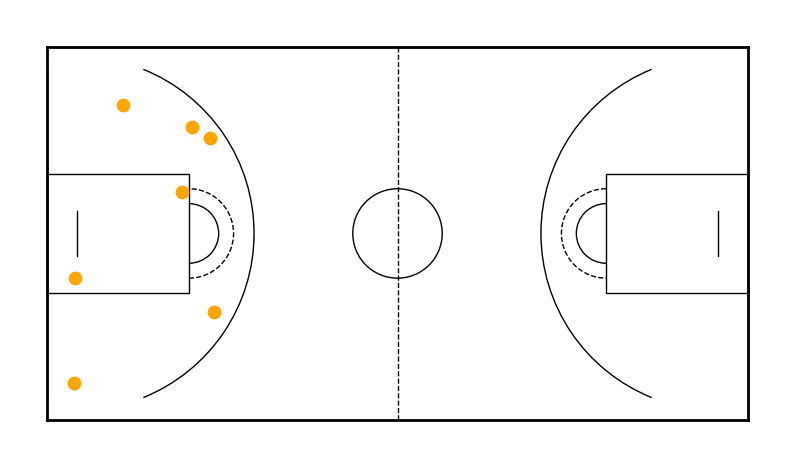

In [ ]:
# Full court with points for poster board image

def draw_full_court(ax):
    # Outer boundary
    ax.plot([0,94],[0,0],'k',linewidth=2)
    ax.plot([0,94],[50,50],'k',linewidth=2)
    ax.plot([0,0],[0,50],'k',linewidth=2)
    ax.plot([94,94],[0,50],'k',linewidth=2)

    # Half‑court
    ax.plot([47,47],[0,50],'k--',linewidth=1)
    ax.add_patch(Circle((47,25),6,fill=False,linewidth=1))     # center circle

    # Keys
    ax.add_patch(Rectangle((0,17),19,16,fill=False,linewidth=1))       # left key
    ax.add_patch(Rectangle((94-19,17),19,16,fill=False,linewidth=1))  # right key
    # restricted areas
    ax.add_patch(Arc((19,25),8,8,theta1=-90,theta2=90,fill=False,linewidth=1))
    ax.add_patch(Arc((94-19,25),8,8,theta1=90,theta2=270,fill=False,linewidth=1))

    # Free‑throw semicircles (dashed)
    ax.add_patch(Arc((19,25),12,12,theta1=270,theta2=90,fill=False,
                     linewidth=1,linestyle='--'))
    ax.add_patch(Arc((94-19,25),12,12,theta1=90,theta2=270,fill=False,
                     linewidth=1,linestyle='--'))

    # Three‑point lines
    # corner threes
    ax.plot([0,0],[3,50-3],'k',linewidth=1)
    ax.plot([94,94],[3,50-3],'k',linewidth=1)
    # arcs centered at the baskets (4 ft in)
    radius = 23.75
    ax.add_patch(Arc((4,25), radius*2, radius*2,
                     theta1=-68, theta2=68, fill=False,linewidth=1))
    ax.add_patch(Arc((94-4,25), radius*2, radius*2,
                     theta1=112, theta2=248, fill=False,linewidth=1))

    # Backboards (little line at the bottom)
    ax.plot([4,4],[22,28],'k',linewidth=1)
    ax.plot([94-4,94-4],[22,28],'k',linewidth=1)

    ax.set_aspect('equal')
    ax.set_xlim(-5,99)
    ax.set_ylim(-5,55)
    ax.axis('off')
    return ax

# specific file for example
warped_json = "warped_shots/Alabama_vs_Florida State_2024 NCAA women_s first round/frame_4089.json"
data = json.load(open(warped_json))
players = [p for p in data["predictions"] if p["class"]=="Player"]
x_mod = [p["X_model"] for p in players]
y_mod = [p["Y_model"] for p in players]

fig, ax = plt.subplots(figsize=(10,6))
draw_full_court(ax)
ax.scatter(x_mod, y_mod, c='orange', s=80, label='Players')
plt.show()
